Lattice setup and energy calculation

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math
# initialize the codespace with only A-stabilizer 

def lattice_space(L, H):
    lattice = np.zeros((L, H))
    for i in range(L):
        for j in range(H):
            if i % 3 == 0 and j % 3 != 0:
                lattice[i][j] = 1
            if i % 3 == 1 and j % 3 != 2:
                lattice[i][j] = 1
            if i % 3 == 2 and j % 3 != 1:
                lattice[i][j] = 1
    return lattice
lattice = lattice_space(30, 30)
lattice

array([[0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0.,
        1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1.],
       [1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1.,
        1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0.],
       [1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1.,
        0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1.],
       [0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0.,
        1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1.],
       [1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1.,
        1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0.],
       [1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1.,
        0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1.],
       [0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0.,
        1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1., 0., 1., 1.],
       [1., 1., 0., 1., 1., 0., 1., 1., 0

In [16]:
import random

def energy(lattice):
    
    H = lattice.shape[0]
    L = lattice.shape[1]
    energy = 0
    for i in range(H):
        for j in range(L):
            # Periodic boundary conditions
            right = lattice[(i+1)% H, (j+1) % L]
            down  = lattice[(i+1) % H, j]
            energy +=  (lattice[i, j] + right + down)% 2
    return energy

def compute_dE(lattice, i, j):
    # Sum over four neighbors with periodic boundaries
    H = lattice.shape[0]
    L = lattice.shape[1]
    s = lattice[i, j]
    ds = (s+1)%2
    left = lattice[i, (j-1)%L] + lattice [(i-1)%H, (j-1)%L]
    right = lattice[(i-1)%H, j] + lattice[i, (j+1)%L]
    bottom = lattice[(i+1)%H, j] + lattice[(i+1)%H, (j+1)%L]
    E  = (left+s)%2 + (right+s)%2 + (bottom+s)%2
    E_new = (left+ds)%2 + (right+ds)%2 + (bottom+ds)%2
    dE = E_new - E
    if dE == 0:
        raise ValueError("No change in energy")
    return dE


lattice = lattice_space(9, 9)
print(energy(lattice))

0.0


Monte carlo error, Monte Carlo local decoder, and kinetic monte carlo local decoder

In [3]:
def monte_carlo_error(lattice, num_steps, error_rate):
    H = lattice.shape[0]
    L = lattice.shape[1]
    for _ in range(num_steps):
        i = random.randint(0, H - 1)
        j = random.randint(0, L - 1)
        r = random.random()
        if r < error_rate:
            # Flip the qubit
            lattice[i, j] = (lattice[i, j] + 1) % 2
            """
        for i in range(H):
            for j in range(L):
                r = random.random()
                if r < error_rate:
                    # Flip the qubit
                    lattice[i, j] = (lattice[i, j] + 1) % 2
            """

    return lattice

In [4]:
def local_decoder(lattice, beta, num_steps, error_rate, energy_hist):
    """
    Local decoder that flips qubits based on the energy function.
    """
    for _ in range(num_steps):
        i = random.randint(0, lattice[0] - 1)
        j = random.randint(0, lattice[1] - 1)
        dE = compute_dE(lattice, i, j)
        # if dE < 0:
        #     # Flip the qubit
        #     lattice[i, j] = (lattice[i, j] + 1) % 2
        if random.random() < dE / (1 - np.exp(-beta * dE)) - error_rate:
                lattice[i, j] = (lattice[i, j] + 1) % 2
        energy_hist.append(energy(lattice))
        
    return lattice

In [12]:
def nonzero_random():
    r = random.random()
    while r == 0.0:
        r = random.random()
    return r

def bkl(lattice, beta, steps, engergy_hist, error_rate, time_list):
    f = 1e-8
    H = lattice.shape[0]
    L = lattice.shape[1]
    for step in range(steps):
        # for i_ in range(H):
        #     for j_ in range(L):
        #         r = random.random()
        #         if r < error_rate:
        #             # Flip the qubit
        #             lattice[i_, j_] = (lattice[i_, j_] + 1) % 2

        # Create a dictionary to group spin flips by their energy change (dE)
        classes = {}
        # For each spin, compute its energy change upon flipping
        for i in range(H):
            for j in range(L):
                dE = compute_dE(lattice, i, j)
                if dE not in classes:
                    classes[dE] = []
                classes[dE].append((i, j))
        # print(classes)
        # Calculate transition rates for each class:
        # For spins where flipping lowers energy (dE <= 0), acceptance probability is 1;
        # for dE > 0, it is dE*(1-exp(-beta * dE))
        rates = {}
        total_rate = 0.0
        for dE in sorted(classes):
            rate = len(classes[dE])* (dE / (np.exp(beta * dE)-1 ) )#- error_rate)
            rates[dE] = rate
            total_rate += rate
        if total_rate == 0:
            print(len(classes), "total_rate is 0")
            continue
        # rate_list = []
        # rate_list.append(total_rate)
        # Choose a class according to the rates (weighted selection)
        r = random.uniform(0, total_rate)
        cumulative = 0.0
        chosen_class = None
        for dE, rate in rates.items():
            cumulative += rate
            if r <= cumulative :
                # print("hi")
                chosen_class = dE
                break
        if total_rate == 0.0:
            raise ValueError("Total rate is zero, cannot choose a class.")
            
        # From the chosen class, select a spin uniformly at random
        i, j = random.choice(classes[chosen_class])
        # Flip the spin
        lattice[i, j] = (lattice[i, j] + 1) % 2
        energy_hist.append(energy(lattice))   
        rho3 = nonzero_random()
        step = -1/total_rate * np.log(rho3)
        print(rho3, total_rate)
        
        time_list.append(step)
    return lattice

Just exploration to separate bkl algorithm, not related at this point

In [ ]:

def bkl_base(lattice, beta, steps, engergy_hist, error_rate):
    H = lattice.shape[0]
    L = lattice.shape[1]
    
    # Create a dictionary to group spin flips by their energy change (dE)
    classes = {}
    # For each spin, compute its energy change upon flipping
    for i in range(H):
        for j in range(L):
            dE = compute_dE(lattice, i, j)
            if dE not in classes:
                classes[dE] = []
            classes[dE].append((i, j))
    # print(classes)
    # Calculate transition rates for each class:
    # For spins where flipping lowers energy (dE <= 0), acceptance probability is 1;
    # for dE > 0, it is dE*(1-exp(-beta * dE))
    rates = {}
    total_rate = 0.0
    for dE in sorted(classes):
        rate = len(classes[dE])* (dE / (1 - np.exp(-beta * dE)) - error_rate)
        rates[dE] = rate
        total_rate += rate
    
    # Choose a class according to the rates (weighted selection)
    r = random.uniform(0, total_rate)
    cumulative = 0.0
    chosen_class = None
    for dE, rate in rates.items():
        cumulative += rate
        if r <= cumulative :
            print("hi")
            chosen_class = dE
            # break
    
    # From the chosen class, select a spin uniformly at random
    i, j = random.choice(classes[chosen_class])
    # Flip the spin
    lattice[i, j] = (lattice[i, j] + 1) % 2
    new_label =compute_dE(lattice, i, j)
    classes[new_label].append((i, j))
    # Remove the flipped spin from its old class   
    classes[chosen_class].remove((i, j))    

    return lattice, classes

def bkl_evolve(lattice, classes, beta, steps, engergy_hist, error_rate):
    rates = {}
    total_rate = 0.0
    for dE in sorted(classes):
        rate = len(classes[dE])* (dE / (1 - np.exp(-beta * dE)) - error_rate)
        rates[dE] = rate
        total_rate += rate
    
    # Choose a class according to the rates (weighted selection)
    r = random.uniform(0, total_rate)
    cumulative = 0.0
    chosen_class = None
    for dE, rate in rates.items():
        cumulative += rate
        if r <= cumulative :
            print("hi")
            chosen_class = dE
            # break
    
    # From the chosen class, select a spin uniformly at random
    i, j = random.choice(classes[chosen_class])
    # Flip the spin
    lattice[i, j] = (lattice[i, j] + 1) % 2
    new_label =compute_dE(lattice, i, j)
    classes[new_label].append((i, j))
    # Remove the flipped spin from its old class   
    classes[chosen_class].remove((i, j))    

    return lattice, classes

Engery evolution in Monte carlo errors and in bkl local decoder with respect to bkl time steps

0.0
0.0514973298757484 14.4
0.15302165717231486 19.601930611122075
0.5389248701172558 24.803861222244144
0.26734793015410907 19.601930611122075
0.720489875075748 14.4
0.1961518725257282 19.601930611122075
0.2236691493419396 24.803861222244144
0.9420067364224098 19.601930611122075
0.11443047592762057 24.803861222244144
0.3502287525114264 30.00579183336622
0.16919912664327041 31.106757138927257
0.9151636848181335 36.30868775004933
0.4454851042132818 37.40965305561037
0.25684553605490834 38.5106183611714
0.16380206365360017 45.611583666732436
0.15371952420574586 42.61158366673244
0.3138391803904438 44.34556053710646
0.49834501221850447 46.07953740748049
0.5117471866903669 51.28146801860256
0.13834986305848607 49.54749114822854
0.8492131251556703 50.64845645378957
0.7363229036631428 55.850387064911644
0.8764362010005596 57.584363935285666
0.7485140434340312 59.318340805659695
0.6908293177287728 57.58436393528567
0.6295329079046336 58.05231767603371
0.5751053863472476 63.88725985196878
0.74

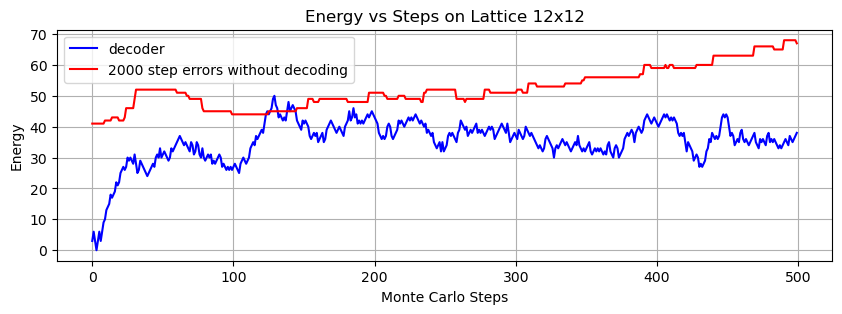

In [6]:
error_rate =0.1
classes = {}
energy_hist = []
time_list = []
H = 12
L = 12
lattice = lattice_space(H, L)

beta = math.log((3+error_rate)/error_rate)/3
# lattice = monte_carlo_error(lattice, 1000, error_rate)
print(energy(lattice))
bkl(lattice, beta, 500, energy_hist, error_rate, time_list)

bar_list = [] 
lattice1 = lattice.copy()
for i in range(len(time_list)):
    lattice1 = monte_carlo_error(lattice1, 1, error_rate)
    bar_list.append(energy(lattice1))

# plot the decoding process in energy changes
x = np.arange(len(energy_hist))
# bar = np.full(shape=len(energy_hist), fill_value=bar)
plt.figure(figsize=(10, 3))
plt.plot(x, energy_hist, color ='blue', label='decoder')
plt.plot(x, bar_list, color ='red',  label='2000 step errors without decoding')
plt.xlabel('Monte Carlo Steps')
plt.ylabel('Energy')
plt.title(f'Energy vs Steps on Lattice {H}x{L}')
plt.legend()
plt.grid()
plt.show()




0.0
0.008668754125316425 14.4
0.14287260846008443 19.601930611122075
0.9241280265062396 24.803861222244144
0.7980828548037148 30.00579183336622
0.10853998886939253 24.803861222244144
0.1493877250593828 19.601930611122075
0.13117276143960133 24.803861222244144
0.48894094036212044 30.00579183336622
0.38331205695224624 36.473745574114275
0.09464532023479666 30.00579183336622
0.9894865977081168 24.803861222244144
0.4787984566063833 19.601930611122075
0.1727264296229819 24.803861222244144
0.5474075980773146 25.904826527805184
0.700783016176027 24.803861222244144
0.37035605124635174 30.00579183336622
0.21761015261457284 31.106757138927257
0.9663486568056494 38.20772244448829
0.8597440236621359 35.84073400930128
0.02334370626746385 36.30868775004933
0.6309833746307351 38.04266462042335
0.7770734058210091 43.244595231545425
0.7010717358892694 44.97857210191945
0.03165483608363728 39.77664149079738
0.921575726946682 37.40965305561036
0.00427223639721841 35.04266462042335
0.6227194773941473 29.8

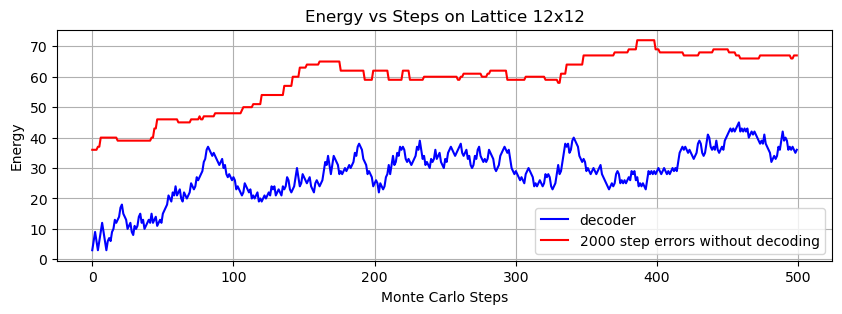

In [7]:
error_rate =0.1
classes = {}
energy_hist = []
time_list = []
H = 12
L = 12
lattice = lattice_space(H, L)

beta = math.log((3+error_rate)/error_rate)/3
# lattice = monte_carlo_error(lattice, 1000, error_rate)
print(energy(lattice))
bkl(lattice, beta, 500, energy_hist, error_rate, time_list)

bar_list = [] 
lattice1 = lattice.copy()
for i in range(len(time_list)):
    lattice1 = monte_carlo_error(lattice1, int(time_list[i]+1), error_rate)
    bar_list.append(energy(lattice1))

# plot the decoding process in energy changes
x = np.arange(len(energy_hist))
# bar = np.full(shape=len(energy_hist), fill_value=bar)
plt.figure(figsize=(10, 3))
plt.plot(x, energy_hist, color ='blue', label='decoder')
plt.plot(x, bar_list, color ='red',  label='2000 step errors without decoding')
plt.xlabel('Monte Carlo Steps')
plt.ylabel('Energy')
plt.title(f'Energy vs Steps on Lattice {H}x{L}')
plt.legend()
plt.grid()
plt.show()




In [23]:
time_list

[np.float64(0.031448451474352816),
 np.float64(0.0743235972915328),
 np.float64(0.07389323005957191),
 np.float64(0.06397568364981318),
 np.float64(0.0015949865096297144),
 np.float64(0.16646341494628905),
 np.float64(0.007301601590100047),
 np.float64(0.09209328323518631),
 np.float64(0.03480673611192827),
 np.float64(0.0022218674540094626),
 np.float64(0.019378006374199147),
 np.float64(0.00288401969021375),
 np.float64(0.12680744555631643),
 np.float64(0.09728152810187239),
 np.float64(0.01028085660083624),
 np.float64(0.008743796504138356),
 np.float64(0.05021567293441899),
 np.float64(0.07776858344186874),
 np.float64(0.007072324612518123),
 np.float64(0.03927703949348746),
 np.float64(0.01278401063559436),
 np.float64(0.00580482955838533),
 np.float64(0.0024802284109759877),
 np.float64(0.025403733888422722),
 np.float64(0.0905295760143455),
 np.float64(0.004756619755635962),
 np.float64(0.009328138166168393),
 np.float64(0.024958734432901142),
 np.float64(0.0456424120903488),
 n

0.0
0.5633684719863886 129.6
0.9699728401220871 134.8019306111221
0.06260432678291727 140.00386122224415
0.09111910303862159 145.20579183336622
0.9191019680732438 151.67374557411426
0.2105859492767671 145.20579183336622
0.5078269781806345 150.40772244448831
0.55822459740124 145.20579183336622
0.7359617376659847 150.40772244448831
0.009471518083793762 155.60965305561038
0.5442043696064506 160.81158366673245
0.09172179799500702 166.0135142778545
0.8051237603500736 160.81158366673245
0.9583609409226056 166.0135142778545
0.6104511609346409 171.21544488897658
0.5156156424190037 176.41737550009867
0.5363035618147491 181.61930611122074
0.6227085270007751 186.8212367223428
0.15130920124406477 192.02316733346487
0.4344179135373599 193.1241326390259
0.17756368752650553 187.92220202790384
0.14462471032466884 193.1241326390259
0.7517470014593556 199.59208637977397
0.10254118823611547 193.1241326390259
0.3888691742467828 190.1241326390259
0.7223805703815805 195.326063250148
0.4219221102058265 200.5

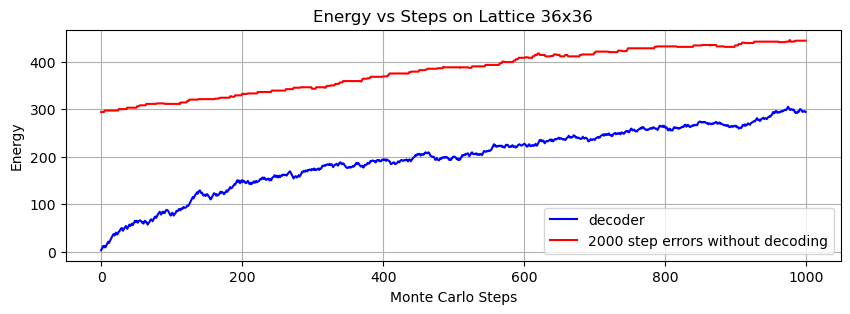

In [8]:
error_rate =0.1
classes = {}
energy_hist = []
time_list = []
H = 36
L = 36
lattice = lattice_space(H, L)

beta = math.log((3+error_rate)/error_rate)/3
# lattice = monte_carlo_error(lattice, 1000, error_rate)
print(energy(lattice))
bkl(lattice, beta, 1000, energy_hist, error_rate, time_list)

bar_list = [] 
lattice1 = lattice.copy()
for i in range(len(time_list)):
    lattice1 = monte_carlo_error(lattice1, int(time_list[i]+1), error_rate)
    bar_list.append(energy(lattice1))
    print(energy(lattice1))

# plot the decoding process in energy changes
x = np.arange(len(energy_hist))
# bar = np.full(shape=len(energy_hist), fill_value=bar)
plt.figure(figsize=(10, 3))
plt.plot(x, energy_hist, color ='blue', label='decoder')
plt.plot(x, bar_list, color ='red',  label='2000 step errors without decoding')
plt.xlabel('Monte Carlo Steps')
plt.ylabel('Energy')
plt.title(f'Energy vs Steps on Lattice {H}x{L}')
plt.legend()
plt.grid()
plt.show()




0.0
0.9858301740162954 396.0
0.752403884798125 401.20193061112207
0.3848414718406675 406.4038612222442
0.4138124650289713 411.60579183336625
0.8750158178493476 416.8077224444883
0.16900546072603417 422.0096530556104
0.9644743359987806 427.21158366673245
0.5100004309819322 432.4135142778545
0.07328512232969553 437.61544488897664
0.05414023095953702 442.8173755000987
0.7513832757907937 448.0193061112207
0.45990859402448536 453.22123672234284
0.7762788074142456 458.4231673334649
0.3099394751294565 463.62509794458697
0.747001766503001 468.82702855570903
0.6060694876164525 474.0289591668311
0.3174593735016429 468.82702855570903
0.8162284620038027 469.92799386127007
0.6906813181861106 475.12992447239213
0.2985612397044616 480.33185508351426
0.997242359729313 485.5337856946363
0.7111032633460717 490.7357163057584
0.45853298994126235 495.93764691688045
0.8466411486446881 490.7357163057584
0.39811355998117415 495.93764691688045
0.24621356688528617 501.7725890928155
0.17134308437168633 506.97451

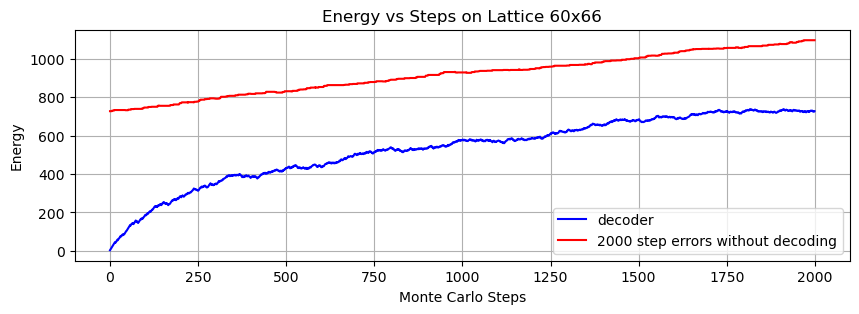

In [50]:
error_rate =0.1
classes = {}
energy_hist = []
time_list = []
H = 60
L = 66
lattice = lattice_space(H, L)

beta = math.log((3+error_rate)/error_rate)/3
# lattice = monte_carlo_error(lattice, 1000, error_rate)
print(energy(lattice))
bkl(lattice, beta, 2000, energy_hist, error_rate, time_list)

bar_list = [] 
lattice1 = lattice.copy()
for i in range(len(time_list)):
    lattice1 = monte_carlo_error(lattice1, int(time_list[i]+1), error_rate)
    bar_list.append(energy(lattice1))
    print(energy(lattice1))

# plot the decoding process in energy changes
x = np.arange(len(energy_hist))
# bar = np.full(shape=len(energy_hist), fill_value=bar)
plt.figure(figsize=(10, 3))
plt.plot(x, energy_hist, color ='blue', label='decoder')
plt.plot(x, bar_list, color ='red',  label='2000 step errors without decoding')
plt.xlabel('Monte Carlo Steps')
plt.ylabel('Energy')
plt.title(f'Energy vs Steps on Lattice {H}x{L}')
plt.legend()
plt.grid()
plt.show()




import math
import numpy as np
# constants
L = 1000
H = 1000
error_rate = 0.00001
beta = math.log((6+error_rate)/error_rate)/6       # Inverse temperature
step_list = [1000, 3000, 5000, 10000, 30000, 50000, 70000, 100000, 150000, 3000000, 350000, 4000000, 5000000]    # Number of Monte Carlo steps
energy_hist = np.empty((len(step_list), 2))

# Test the local decoder with different step sizes
for k in range(len(step_list)):
    
    # Initialize the lattice
    lattice = lattice_space(L, H)
    lattice = monte_carlo_error(lattice, 1000, error_rate)
    print("Initial energy:", energy(lattice))
    energy_hist[k][0] = energy(lattice)
    final_lattice = local_decoder(lattice, beta, step_list[k], error_rate)
    print("Final energy:", energy(final_lattice))
    energy_hist[k][1] = energy(final_lattice)

i = energy_hist[9][1]
energy_hist[9][1] = energy_hist[10][1]
energy_hist[10][1] = i  

import matplotlib.pyplot as plt
plt.plot(step_list, energy_hist[:, 0], label='Initial Energy')
plt.plot(step_list, energy_hist[:, 1], label='Final Energy')
plt.xlabel('Number of Steps')
plt.ylabel('Energy')
plt.title('Energy vs Number of Steps')
plt.legend()
plt.show()


i = energy_hist[9][1]
energy_hist[9][1] = energy_hist[10][1]
energy_hist[10][1] = i

import matplotlib.pyplot as plt
plt.plot(step_list, energy_hist[:, 0], label='Initial Energy')
plt.plot(step_list, energy_hist[:, 1], label='Final Energy')
plt.xlabel('Number of Steps')
plt.ylabel('Energy')
plt.title('Energy vs Number of Steps')
plt.legend()
plt.show()

The actual optimal decoder

In [90]:
# optimal decoder
def syndrome_detector(lattice):
    """
    Detects errors in syndrom measuring A-stabilizer
    """
    H = lattice.shape[0]
    L = lattice.shape[1]
    errors = []
    #errors = np.zeros((H,L))
    for i in range(H):
        for j in range(L):
            if (lattice[i, j]+lattice[i, (j+1)%L]+lattice[(i+1)%H, (j+1)%L]) % 2 != 0:  # error by A-stablizer
                #errors[i][j]= 1
                errors.append((i,j))   
    return errors

def error_qubit_detector(lattice):
    """
    Detects errors in the lattice and returns a list of qubits to be flipped.
    """
    H = lattice.shape[0]
    L = lattice.shape[1]
    errors = syndrome_detector(lattice)
    error_qubits = np.zeros((H,L),dtype=int)
    for i in range(H):
        for j in range(L):
            if not (errors[i][j] or errors[(i-1)%H][j] or errors[(i-1)%H][(j-1)%L]):  
                error_qubits[i][j]= 1   # Assuming 1 indicates an error
    return error_qubits

def sweeper(lattice):
    """
    Sweeps through the lattice and move the defects. to the first row.
    """
    H = lattice.shape[0]
    L = lattice.shape[1]
    errors = np.zeros((H,L))
    
    for i in range(H-1):      # to H or H-1?/
        for j in range(L):
            if (lattice[(H-i-1)%H, j]+lattice[(H-i)%H, j]+lattice[(H-i)%H, (j+1)%L]) % 2 != 0:  # error by A-stablizer
                errors[i][j]= 1
                lattice[H-i-1][j] = (lattice[H-i-1][j] + 1) % 2 
    return lattice, errors

def update_rule(lattice):
    """
    Update rule 102, input row_i, returns row_i+1
    """
    H = lattice.shape[0]
    L = lattice.shape[1]
    f = np.zeros((L,L),dtype=int)
    counter = 0
    for j in range(L):
        f[j][counter] = 1
        f[(j+1)% L][counter] = 1
        counter += 1
    
    return f

def invert_mod2(A: np.ndarray) -> np.ndarray:
    """
    Compute the inverse of a square binary matrix A over GF(2).
    
    Parameters
    ----------
    A : (n,n) array_like of {0,1}
        The matrix to invert; must be square and of full rank mod 2.
    
    Returns
    -------
    A_inv : (n,n) ndarray of {0,1}
        The inverse of A in Z_2, so that A_inv @ A ≡ I mod 2.
    
    Raises
    ------
    ValueError
        If A is not square or not invertible over Z_2.
    """
    A = np.array(A, dtype=np.uint8) & 1
    n, m = A.shape
    if n != m:
        raise ValueError(f"Matrix must be square, got shape {A.shape}")
    
    # Build the augmented matrix [A | I]
    aug = np.concatenate([A, np.eye(n, dtype=np.uint8)], axis=1)  # shape (n, 2n)
    
    # Gauss–Jordan elimination
    row = 0
    for col in range(n):
        # 1) Find a pivot in or below current row
        pivot = None
        for r in range(row, n):
            if aug[r, col]:
                pivot = r
                break
        if pivot is None:
            # no pivot => singular
            raise ValueError("Matrix is singular in GF(2), cannot invert")
        
        # 2) Swap pivot row into place if needed
        if pivot != row:
            aug[[row, pivot], :] = aug[[pivot, row], :]
        
        # 3) Eliminate all other 1’s in this column
        for r in range(n):
            if r != row and aug[r, col]:
                # row r ← row r XOR row 'row'
                aug[r, :] ^= aug[row, :]
        
        row += 1
    
    # At this point the left n×n block is I, so the right block is A^{-1}
    A_inv = aug[:, n:]  # shape (n, n)
    return A_inv

def optimal_decoder(lattice):
    """
    Optimal decoder using sweeper. # treat S as column vector
    """
    H = lattice.shape[0]
    L = lattice.shape[1]
    # lattice1, _ = sweeper(lattice)
    S = np.transpose(lattice[0])
    f = update_rule(lattice)
    f = np.linalg.matrix_power(f, H-1) % 2
    f1 = f.copy() 
    for i in range(L):
        f1[:,(i+1) % L] = f[:,i] #######################. is it i+1 or i-1?

    A = np.eye(L) + f + f1
    A_inv = invert_mod2(A)
    E = A_inv @ S
    # E = np.transpose(E)
    # diff = E - S
    """
    try:
        A_inv = np.linalg.inv(A)
        
        # Step 4: Validate by checking that A * A_inv is approximately the identity matrix.
        identity = np.dot(A, A_inv)
        
        if np.allclose(identity, np.eye(A.shape[0])):
            print("\nThe inversion is verified: A * A_inv is approximately the identity matrix.")
        else:
            print("\nWarning: A * A_inv is not the identity matrix.")
        
    except np.linalg.LinAlgError:
        print("The matrix is singular and cannot be inverted.")

    """
    return E
    # return e_int, S, E, diff

def C2_constructor(E, lattice):
    """
    Construct the C2 code from the error syndrome in line 0. Again E is the first row written as column vector.
    """
    H = lattice.shape[0]
    L = lattice.shape[1]
    C2 = np.zeros((H, L))
    f = update_rule(lattice)
    for i in range(H):
        C2[:,i] = (np.linalg.matrix_power(f, i) & 1 ) @ E
    C2 = np.transpose(C2)
    return C2

def logical_operators(lattice):
    H = lattice.shape[0]
    L = lattice.shape[1]
    lattice = np.array(lattice_space(H, L))
    f = update_rule(lattice)
    lattice1 = f @ lattice  % 2
    lattice2 = (lattice + lattice1) % 2
    lattice3 = np.zeros((H, L))
    logicals = [lattice, lattice1, lattice2, lattice3]      # 1. in x direction 2. in y direction 3. in both directions 4.vaccum
    return logicals

def logical_checks(lattice):
    """
    Optimal decoder using sweeper.
    """
    H = lattice.shape[0]
    L = lattice.shape[1]
    R = logical_operators(lattice)
    lattice1, C1 = sweeper(lattice)
    S = np.transpose(lattice1[0])
    f = update_rule(lattice)
    f = np.linalg.matrix_power(f, H-1) % 2
    f1 = f.copy() 
    for i in range(H):
        f1[:,(i-1) % H] = f[:,i] 

    A = np.eye(H) + f + f1
    A_inv = invert_mod2(A)
    E = A_inv @ S
    C2 = C2_constructor(E, lattice)
    weight1 = ( (R[0] + C1 + C2 ) % 2 ).sum()
    weight2 = ( (R[1] + C1 + C2) % 2 ).sum()
    weight3 = ( (R[2] + C1 + C2 )% 2 ).sum()
    weight4 = ( (R[3] + C1 + C2) % 2 ).sum()
    weights = [weight1, weight2, weight3, weight4]
    min_weight = min(weights)
    min_index = weights.index(min_weight)
    print(weights)
    if min_index != 0:
        return False #min_index
    else:
        return True


In [73]:
def optimal_decoder_(lattice):
    """
    Optimal decoder using sweeper.
    """
    H = lattice.shape[0]
    L = lattice.shape[1]
    # lattice1, _ = sweeper(lattice)
    S = lattice[0]
    f = update_rule(lattice)
    f = np.linalg.matrix_power(f, H) % 2
    f1 = f 
    for i in range(L):
        f1[:,(i+1) % L] = f1[:,i] 

    A = np.eye(L) + f + f1
    A_inv = invert_mod2(A)
    E = A_inv @ S
    return E

Decoding monte carlo evolved systems with decoder, interepted coz long computation time

In [54]:
error_rate = 0.0001
beta = math.log((3+error_rate)/error_rate)/3
lattice = lattice_space(12, 12)
print(lattice)
energy_hist = []
random.seed(3)
truncated = False
step = 0
while not truncated:
    step  += 1
    lattice = monte_carlo_error(lattice, 1 , error_rate)
    # print(syndrome_detector(lattice))
    # print(lattice)
    lattice1, C1 = sweeper(lattice)
    E = optimal_decoder_(lattice)
    C2 = C2_constructor(E, lattice)
    E_ = (C1 + C2) % 2
    # print(E_)
    # lattice1 = lattice.astype(np.int_)
    # plt.figure(figsize=(4, 4))
    # plt.imshow(lattice1, cmap='binary', interpolation='nearest')
    # plt.show()

    # plt.figure(figsize=(4, 4))
    # plt.imshow(E_, cmap='binary', interpolation='nearest')
    # plt.show()
    # # lattice = bkl(lattice, beta, 1, energy_hist, error_rate)
    truncated = not logical_checks(lattice)
    
step





[[0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1.]
 [1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0.]
 [1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1.]
 [0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1.]
 [1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0.]
 [1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1.]
 [0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1.]
 [1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0.]
 [1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1.]
 [0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1.]
 [1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0.]
 [1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1.]]
[np.float64(0.0), np.float64(96.0), np.float64(96.0), np.float64(96.0)]
[np.float64(0.0), np.float64(96.0), np.float64(96.0), np.float64(96.0)]
[np.float64(0.0), np.float64(96.0), np.float64(96.0), np.float64(96.0)]
[np.float64(0.0), np.float64(96.0), np.float64(96.0), np.float64(96.0)]
[np.float64(0.0), np.float64(96.0), np.float64(96.0), np.float64(96.0)]
[np.float64(0.0), np.float64(96.0), np.float64(96.0), np.float64(96.0)]
[np.float64(0.0), np.float64(96.0), np.float64(96.0), np.float64(96.0)]
[np.float64(0.0), np.float6

KeyboardInterrupt: 

Optimal decoding on local decoder evolution 

In [1]:
error_rate = 0.0005
beta = math.log((3+error_rate)/error_rate)/3
lattice = lattice_space(12, 12)
energy_hist = []
time_list = []
random.seed(10)
# lattice = monte_carlo_error(lattice, 2, error_rate)
truncated = False
step = 0
while not truncated:
    step += 1
    lattice = bkl(lattice, beta, 1, energy_hist, error_rate, time_list)
    lattice1, C1 = sweeper(lattice)
    E = optimal_decoder(lattice)
    C2 = C2_constructor(E, lattice)
    E_ = (C1 + C2) % 2
    # print(lattice)
    # print(E_)
    # plt.figure(figsize=(4, 4))
    # plt.imshow(lattice, cmap='binary', interpolation='nearest')
    # plt.show()

    # plt.figure(figsize=(4, 4))
    # plt.imshow(E_, cmap='binary', interpolation='nearest')
    # plt.show()
    # lattice = bkl(lattice, beta, 1, energy_hist, error_rate)
    
    truncated = not logical_checks(lattice)

step




NameError: name 'math' is not defined

Not related below this

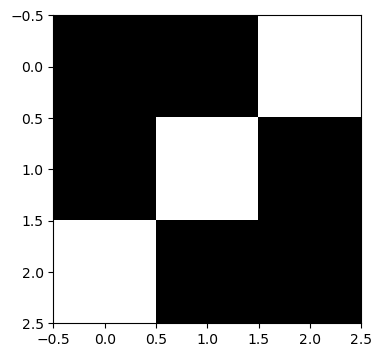

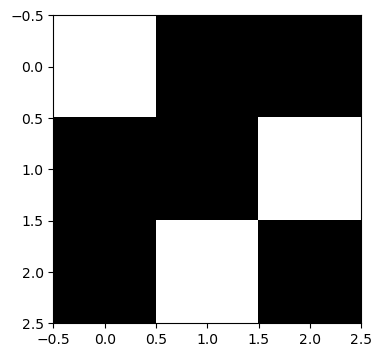

In [29]:
error_rate = 0.0001
lattice = lattice_space(12, 12)
# lattice = np.zeros((3,3))
lattice1 = lattice.copy()
lattice2 = monte_carlo_error(lattice, 1000, error_rate)
# lattice = local_decoder(lattice, )
lattice, C1 = sweeper(lattice2)
E = optimal_decoder(lattice)
C2 = C2_constructor(E, lattice)
C1, C2
R1 = np.zeros((3,3))
lattice = lattice1* ((C1 + C2) % 2 )
plt.figure(figsize=(4, 4))
plt.imshow(lattice2, cmap='binary', interpolation='nearest')

# plt.grid()
plt.show()
plt.figure(figsize=(4, 4))
plt.imshow(lattice1, cmap='binary', interpolation='nearest')
# plt.grid()
plt.show()

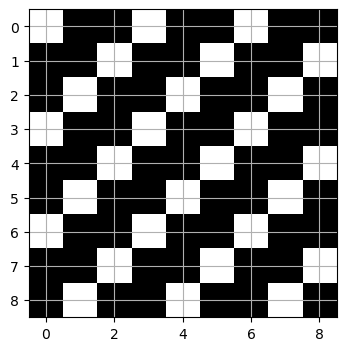

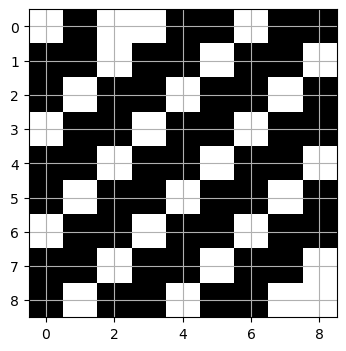

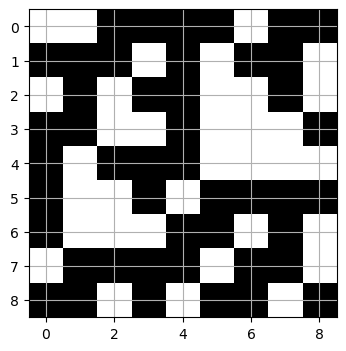

The matrix is singular and cannot be inverted.


In [171]:
import matplotlib.pyplot as plt
lattice = lattice_space(9, 9)
plt.figure(figsize=(4, 4))
plt.imshow(lattice, cmap='binary', interpolation='nearest')
plt.grid()
plt.show()
lattice = monte_carlo_error(lattice, 2, error_rate = 1)
plt.figure(figsize=(4, 4))
plt.imshow(lattice, cmap='binary', interpolation='nearest')
plt.xticks(np.linespace(0,8,))
plt.grid()
plt.show()
lattice = sweeper(lattice)
plt.figure(figsize=(4, 4))
plt.imshow(lattice, cmap='binary', interpolation='nearest')
plt.grid()
plt.show()
A = optimal_decoder(lattice)
try:
    A_inv = np.linalg.inv(A)
    
    # Step 4: Validate by checking that A * A_inv is approximately the identity matrix.
    identity = np.dot(A, A_inv)
    
    if np.allclose(identity, np.eye(A.shape[0])):
        print("\nThe inversion is verified: A * A_inv is approximately the identity matrix.")
    else:
        print("\nWarning: A * A_inv is not the identity matrix.")
    
except np.linalg.LinAlgError:
    print("The matrix is singular and cannot be inverted.")



In [ ]:
import math
checking_interval = 10
t = 0
truncate = False
L = 9
H = 9
error_rate = 0.01
beta = math.log((3+error_rate)/error_rate)/3
Lattice = lattice_space(L, H)
lattice = Lattice
while not truncate: 
    lattice = local_decoder(lattice, beta, 1, error_rate)
    if t % checking_interval == 0:
        lattice, C1 = sweeper(lattice)
        E = optimal_decoder(lattice)
        C2 = C2_constructor(E, lattice)
        weights = Lattice * C1 * C2
        sum 
        if 
            truncate = True
    else:  
        break
    t += 1

print(t)

IndexError: tuple index out of range

In [59]:
import numpy as np
from scipy.sparse import csc_matrix
import pymatching
# minimum weight perfect matching
H = csc_matrix([[1, 1, 0, 0, 0],
                [0, 1, 1, 0, 0],
                [0, 0, 1, 1, 0],
                [0, 0, 0, 1, 1]])
observables = csc_matrix([[1, 0, 0, 0, 0]])
error_probability = 0.1
weights = np.ones(H.shape[1]) * np.log((1-error_probability)/error_probability)
matching = pymatching.Matching.from_check_matrix(H, weights=weights, faults_matrix=observables)
num_shots = 1000
num_errors = 0
for i in range(num_shots):
    noise = (np.random.random(H.shape[1]) < error_probability).astype(np.uint8)
    syndrome = H@noise % 2
    predicted_observables = matching.decode(syndrome)
    actual_observables = observables@noise % 2
    num_errors += not np.array_equal(predicted_observables, actual_observables)

print(num_errors)  # prints 6
predicted_observables

13


array([0], dtype=uint8)

In [60]:
syndrome = H@noise % 2
predicted_observables = matching.decode(syndrome)
print(predicted_observables)  # prints [1 0 0 0 0]
print(noise)  # prints [1 0 0 0 0]

[0]
[0 0 0 0 0]


In [61]:
def xyz_color_z_stabilzers(H,L):
    stablizers = np.empty((0, H*L), dtype=int)
    row = -1
    for i in range(H):
        row += 1
        for j in range(L):
            line = np.zeros((L*H),dtype=int)
            line[(i+j+row*(L-1))%(H*L)] = 1
            line[(i+j+L+row*(L-1))%(H*L)] =1
            line[(i+j+L+1+row*(L-1))%(H*L)] = 1
            stablizers = np.vstack((stablizers, line))       
    return stablizers

def color_code_z_logical(L, H):
    lattice = np.zeros((L, H))
    for i in range(L):
        for j in range(H):
            if i % 3 == 0 and j % 3 != 0:
                lattice[i][j] = 1
            if i % 3 == 1 and j % 3 != 2:
                lattice[i][j] = 1
            if i % 3 == 2 and j % 3 != 1:
                lattice[i][j] = 1
    return lattice.flatten()



In [62]:
H=xyz_color_z_stabilzers(3,3)
logicals = color_code_z_logical(3,3)
p = 0.01
from pymatching import Matching
matching = Matching.from_check_matrix(H, weights=np.log((1-p)/p), faults_matrix=logicals)
noise = np.random.binomial(1, 0.05, H.shape[1])
#matching = Matching(H)

ValueError: `check_matrix` must contain at most two ones per column, but column 0 has 3 ones.

In [63]:
import numpy as np

from scipy.sparse import hstack, kron, eye, csc_matrix, block_diag


def repetition_code(n):
    """
    Parity check matrix of a repetition code with length n.
    """
    row_ind, col_ind = zip(*((i, j) for i in range(n) for j in (i, (i+1)%n)))
    data = np.ones(2*n, dtype=np.uint8)
    return csc_matrix((data, (row_ind, col_ind)))


def toric_code_x_stabilisers(L):
    """
    Sparse check matrix for the X stabilisers of a toric code with
    lattice size L, constructed as the hypergraph product of
    two repetition codes.
    """
    Hr = repetition_code(L)
    H = hstack(
            [kron(Hr, eye(Hr.shape[1])), kron(eye(Hr.shape[0]), Hr.T)],
            dtype=np.uint8
        )
    H.data = H.data % 2
    H.eliminate_zeros()
    return csc_matrix(H)
H1 = toric_code_x_stabilisers(3)
matching = pymatching.Matching(H1)
H1.toarray()

array([[1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0],
       [0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0],
       [0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0],
       [1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1],
       [0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0],
       [0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1]],
      dtype=uint8)

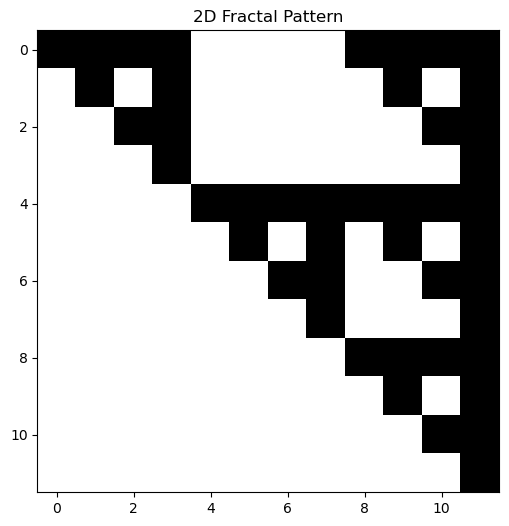

In [94]:
import numpy as np
import matplotlib.pyplot as plt

def generate_pattern(H, L, seed_col=0, wrap=True):
    """
    Generate a 2D pattern using the rule:
        R_i^(j) = (R_i^(j+1) + R_{i+1}^{(j+1)}) mod 2
    where row j is computed from row (j+1).

    Parameters
    ----------
    H : int
        Number of rows in the grid.
    L : int
        Number of columns in the grid.
    seed_col : int
        Which column in the top row is set to 1 as the seed.
    wrap : bool
        If True, use periodic (wrap-around) boundary conditions.

    Returns
    -------
    grid : 2D numpy array of shape (H, L)
        The resulting pattern.
    """
    # Create an empty grid
    grid = np.zeros((H, L), dtype=int)

    # Place a seed (1) in the top row at column 'seed_col'
    if 0 <= seed_col < L:
        grid[H-1, seed_col] = 1
    else:
        raise ValueError("seed_col is out of range")

    # Fill rows from the top (H-1) down to the bottom (0)
    for j in range(H - 2, -1, -1):
        for i in range(L):
            if wrap:
                # Use periodic boundary: neighbor to the right wraps around using modulo L.
                right_index = (i + 1) % L
            else:
                # Without wrap, if i+1 is out of bounds, treat it as 0.
                right_index = i + 1 if i + 1 < L else None

            # If right_index is None, we assume a 0 contribution.
            right_val = grid[j+1, right_index] if right_index is not None else 0
            grid[j, i] = (grid[j+1, i] + right_val) % 2

    return grid

# --------------------- EXAMPLE USAGE --------------------- #

H, L = 12, 12
# Generate and display the pattern using periodic boundary conditions.
pattern = generate_pattern(H, L, seed_col=L-1, wrap=True)

plt.figure(figsize=(6, 6))
plt.imshow(pattern, cmap='binary', interpolation='nearest')
plt.title("2D Fractal Pattern")
#plt.axis('off')
plt.show()


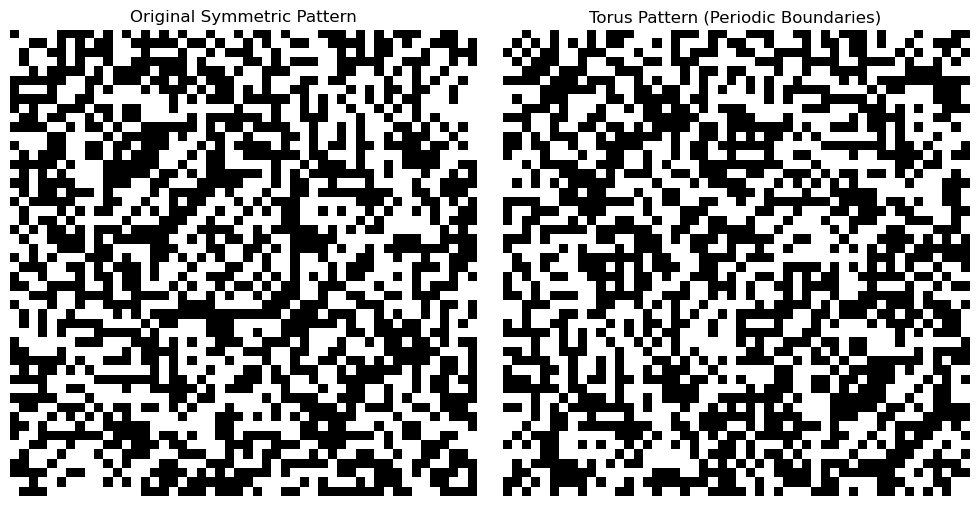

In [1]:
import numpy as np
import matplotlib.pyplot as plt

def generate_symmetric_pattern(N):
    """
    Generate an N x N binary pattern and force mirror symmetry along the diagonal.
    """
    # Create a random binary pattern.
    A = np.random.randint(0, 2, size=(N, N))
    # Force symmetry along the diagonal:
    # Use the upper triangle and mirror it to the lower triangle.
    A_sym = np.triu(A)
    # The diagonal is already in place; add the transpose of the strictly upper part.
    A_sym = A_sym + A_sym.T - np.diag(np.diag(A_sym))
    return A_sym

def create_torus_pattern(pattern, offset):
    """
    Given a square pattern, tile it in a 3x3 grid and extract an N x N window 
    with a given offset to simulate periodic boundary conditions.
    """
    N = pattern.shape[0]
    # Tile the pattern to simulate infinite periodic copies (a torus).
    tiled = np.tile(pattern, (3, 3))
    # Extract the window from the tiled array.
    # The offset lets you choose a different "cut" through the torus.
    torus_pattern = tiled[offset:offset+N, offset:offset+N]
    return torus_pattern

# Set grid size.
N = 50

# Generate a symmetric pattern.
pattern = generate_symmetric_pattern(N)

# To simulate the torus, we take an offset.
# For instance, offset by half the grid size gives a nontrivial cut.
offset = N // 2
torus_pattern = create_torus_pattern(pattern, offset)

# Display the original and torus pattern side by side.
fig, ax = plt.subplots(1, 2, figsize=(10, 5))

# Original pattern (with mirror symmetry, but not wrapped)
ax[0].imshow(pattern, cmap='gray', interpolation='none')
ax[0].set_title("Original Symmetric Pattern")
ax[0].axis('off')

# Pattern as seen on the torus (with periodic identification)
ax[1].imshow(torus_pattern, cmap='gray', interpolation='none')
ax[1].set_title("Torus Pattern (Periodic Boundaries)")
ax[1].axis('off')

plt.tight_layout()
plt.show()
